In [11]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical

# Define the image size and the number of classes
img_size = 128
num_classes = 2

# Define the train and test directories
train_dir = r"/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train"
test_dir = r"/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/test"

# Define the classes
classes = ['DME', 'DRUSEN']

# Create empty lists to store the data and labels
train_data = []
train_labels = []
test_data = []
test_labels = []

# Loop through the train directory to get the images and labels
for class_index, class_name in enumerate(classes):
    class_path = os.path.join(train_dir, class_name)
    for image_name in os.listdir(class_path):
        image_path = os.path.join(class_path, image_name)
        image = cv2.imread(image_path)
        image = cv2.resize(image, (img_size, img_size))
        train_data.append(image)
        train_labels.append(class_index)

# Loop through the test directory to get the images and labels
for class_index, class_name in enumerate(classes):
    class_path = os.path.join(test_dir, class_name)
    for image_name in os.listdir(class_path):
        image_path = os.path.join(class_path, image_name)
        image = cv2.imread(image_path)
        image = cv2.resize(image, (img_size, img_size))
        test_data.append(image)
        test_labels.append(class_index)

# Convert the data and labels to numpy arrays
train_data = np.array(train_data)
train_labels = np.array(train_labels)
test_data = np.array(test_data)
test_labels = np.array(test_labels)

# Split the data into training and validation sets
train_data, val_data, train_labels, val_labels = train_test_split(train_data, train_labels, test_size=0.2, random_state=42)

# Convert the labels to one-hot encoding
train_labels = to_categorical(train_labels, num_classes=num_classes)
val_labels = to_categorical(val_labels, num_classes=num_classes)
test_labels = to_categorical(test_labels, num_classes=num_classes)

In [12]:
print(train_data[1].shape)

(128, 128, 3)


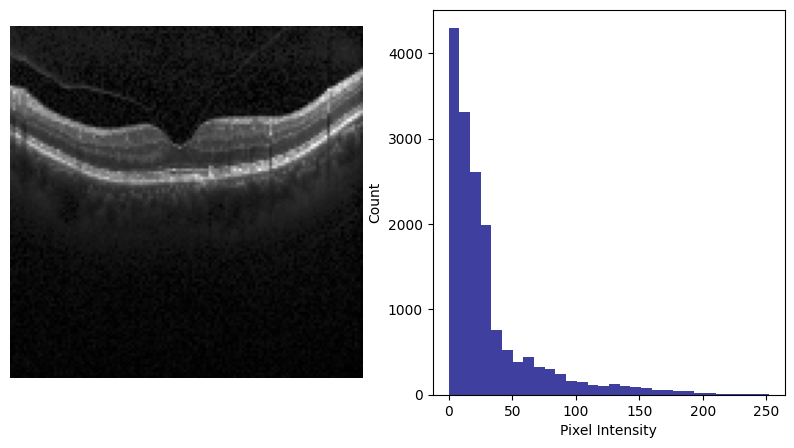

In [13]:
import matplotlib.pyplot as plt

def plotHistogram(a):
    """
    Plot histogram of RGB Pixel Intensities
    """
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(a)
    plt.axis('off')
    histo = plt.subplot(1,2,2)
    histo.set_ylabel('Count')
    histo.set_xlabel('Pixel Intensity')
    n_bins = 30
    plt.hist(a[:,:,0].flatten(), bins= n_bins, lw = 0, color='r', alpha=0.5);
    plt.hist(a[:,:,1].flatten(), bins= n_bins, lw = 0, color='g', alpha=0.5);
    plt.hist(a[:,:,2].flatten(), bins= n_bins, lw = 0, color='b', alpha=0.5);
    
plotHistogram(train_data[1])

In [14]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Sequential, model_from_json
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, Lambda, MaxPool2D, BatchNormalization
from tensorflow.keras import optimizers

# Load the VGG16 model without the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(img_size, img_size, 3))
optimizer = optimizers.Adam(lr=0.0001)


# Freeze the base model layers
for layer in base_model.layers:
    layer.trainable = False

# Create the model and add the top layers
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))
predictions = Dense(num_classes, activation='softmax')
model.add(predictions) # Add predictions layer to the model


# Train top layer
for layer in base_model.layers:
    layer.trainable = False
    
# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
from tensorflow import keras
callbacks_list = [keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=3, verbose=1)]
    
# Print the model summary
model.summary()

# Train the model
history = model.fit(train_data, train_labels, batch_size=32, epochs=20, validation_data=(val_data, val_labels))

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(test_data, test_labels)
print('Test loss:', test_loss)
print('Test accuracy:', test_acc)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 8192)              0         
                                                                 
 dense_2 (Dense)             (None, 128)               1048704   
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)             (None, 2)                 258       
                                                                 
Total params: 15,763,650
Trainable params: 1,048,962
Non-trainable params: 14,714,688
_________________________________________________________________
Epoch 1/20
335/335 [==============

In [15]:
from sklearn.metrics import confusion_matrix
import itertools

def plot_model_results(model, history, test_data, test_labels):
    # Plot accuracy and loss curves
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Val'], loc='upper left')

    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Val'], loc='upper left')

    plt.show()

    # Generate predictions for the test data
    y_pred = np.argmax(model.predict(test_data), axis=1)
    y_true = np.argmax(test_labels, axis=1)

    # Plot confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    classes = np.arange(len(np.unique(y_true)))
    fig, ax = plt.subplots(figsize=(6, 6))
    im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes, yticklabels=classes,
           title='Confusion Matrix',
           ylabel='True Label',
           xlabel='Predicted Label')
    plt.setp(ax.get_xticklabels(),
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        ax.text(j, i, format(cm[i, j], fmt),
                ha="center", va="center",
                color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()

    plt.show()


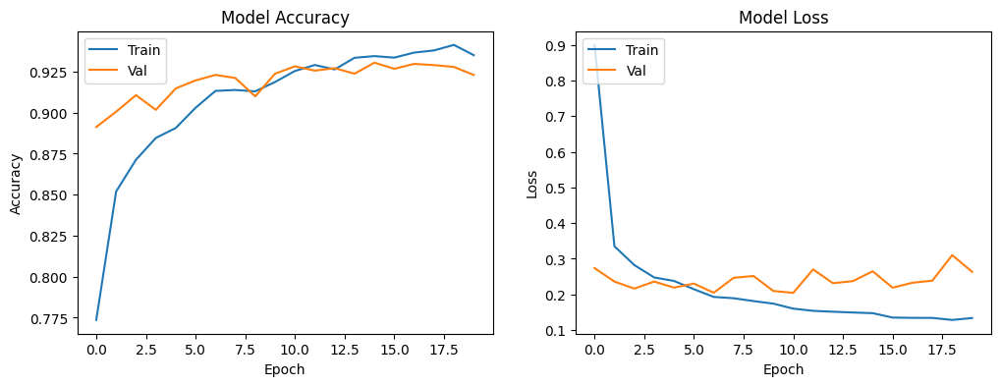

30/30 [==============================] - 2s 51ms/step


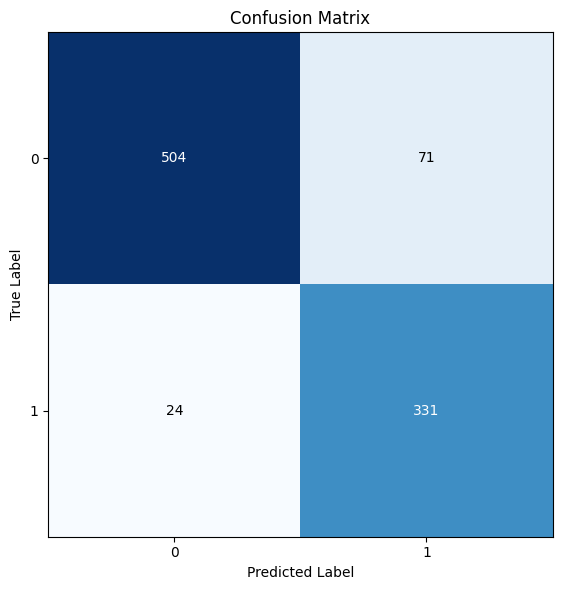

In [16]:
# Plot the model
plot_model_results(model, history, test_data, test_labels)

In [2]:
#!pip install keras==2.3.1
#!pip install tensorflow==2.1.0

/bin/bash: /home/jsmith/miniconda3/envs/tf/lib/libtinfo.so.6: no version information available (required by /bin/bash)
/bin/bash: /home/jsmith/miniconda3/envs/tf/lib/libtinfo.so.6: no version information available (required by /bin/bash)
ERROR: Could not find a version that satisfies the requirement tensorflow==2.1.0 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.12.0rc0, 2.12.0rc1)
ERROR: No matching distribution found for tensorflow==2.1.0


# MIDTERM ASSIGNMENT STARTS HERE - ABOVE IS ASSIGNMENT II FOR REFERENCE

In [15]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

import glob
import os

from keras import Input
from keras.applications import VGG19
from keras.callbacks import TensorBoard
from keras.layers import BatchNormalization, Activation, LeakyReLU, Add, Dense
from keras.layers import Conv2D, UpSampling2D
from keras.models import Model
from keras.optimizers import Adam


import random
from numpy import asarray
from itertools import repeat

import imageio
from imageio import imread
from PIL import Image
from skimage.transform import resize as imresize
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [16]:
import os
import random
import shutil

# Set the path to the train directory
train_dir = "/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/"

# Create the val directory
val_dir = "/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/val/"
os.makedirs(val_dir, exist_ok=True)

# Define the split percentage
split_pct = 0.3

# Create subdirectories in train and val directories for DME and DRUSEN
for subdir in ['DME', 'DRUSEN']:
    os.makedirs(os.path.join(train_dir, subdir), exist_ok=True)
    os.makedirs(os.path.join(val_dir, subdir), exist_ok=True)

    # Get a list of file names for this subdirectory
    file_names = os.listdir(os.path.join(train_dir, subdir))

    # Shuffle the list of file names
    random.shuffle(file_names)

    # Split the file names into train and val sets
    split_idx = int(len(file_names) * (1 - split_pct))
    train_files = file_names[:split_idx]
    val_files = file_names[split_idx:]

    # Move the files into the appropriate directories
    for file_name in train_files:
        src_path = os.path.join(train_dir, subdir, file_name)
        dest_path = os.path.join(train_dir, subdir, file_name)
        shutil.move(src_path, dest_path)

    for file_name in val_files:
        src_path = os.path.join(train_dir, subdir, file_name)
        dest_path = os.path.join(val_dir, subdir, file_name)
        shutil.move(src_path, dest_path)

In [17]:
# data path
TRAIN_PATH = r'/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/'
VAL_PATH = r'/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/val/'
TEST_PATH = r'/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/test/'
data_path = TRAIN_PATH

epochs = 150

# batch size equals to 8 (due to RAM limits)
batch_size = 8

# define the shape of low resolution image (LR) 
low_resolution_shape = (32, 32, 3)

# define the shape of high resolution image (HR) 
high_resolution_shape = (128, 128, 3)

# optimizer for discriminator, generator 
common_optimizer = Adam(0.0002, 0.5)

# use seed for reproducible results
SEED = 2020 
tf.random.set_seed(SEED)

In [18]:
# Define a function that takes a path to image data as an argument
def get_train_images(data_path):
    
    # Define the two classes of images we're looking for
    CLASSES = ['DME', 'DRUSEN']
    
    # Create an empty list to store image file paths
    image_list = []

    # Loop through each class of images
    for class_type in CLASSES:
        # Use the glob module to find all image files within the folder for that class
        # and add the resulting list of file paths to the image_list using the extend method
        image_list.extend(glob.glob(data_path + class_type + '/*'))
    
    # Return the complete list of image file paths
    return image_list

In [19]:
image_list = get_train_images(data_path)

In [20]:
# Print Image list
image_list

['/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-4897748-77.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-8231523-16.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-8525575-53.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-3304080-13.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-7872718-12.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-2261889-10.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-4463692-5.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-8525575-62.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-3441556-67.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/DME/DME-1726544-16.jpeg',
 '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermP

In [21]:
# Define a function that takes a list of image file paths as an argument
def find_img_dims(image_list):
    
    # Initialize empty lists to store minimum and maximum image sizes
    min_size = []
    max_size = []
    
    # Loop through each image in the list
    for i in range(len(image_list)):
        # Open the image file using the Image module from PIL
        im = Image.open(image_list[i])
        # Add the minimum and maximum dimensions of the image to their respective lists
        min_size.append(min(im.size))
        max_size.append(max(im.size))
    
    # Return the overall minimum and maximum image dimensions as a tuple
    return min(min_size), max(max_size)

In [22]:
# get min/max image sizes

image_list = get_train_images(data_path)
min_size, max_size = find_img_dims(image_list)
print('The min and max image dims are {} and {} respectively.'
      .format(min_size, max_size))

The min and max image dims are 496 and 1536 respectively.


In [23]:
# data path
TRAIN_PATH = r'/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train/'
data_path = TRAIN_PATH

In [24]:
import shutil

src_folder = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/train'
dst_folder = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/original_train_images'

shutil.copytree(src_folder, dst_folder)

'/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/original_train_images'

In [25]:
# Define a function that takes two images as input
def compute_psnr(original_image, generated_image):
    
    # Convert the input images to TensorFlow tensors with dtype float32
    original_image = tf.convert_to_tensor(original_image, dtype=tf.float32)
    generated_image = tf.convert_to_tensor(generated_image, dtype=tf.float32)
    
    # Use the TensorFlow image module to compute the peak signal-to-noise ratio (PSNR) between the two images
    # Set the maximum value of the images to 1.0
    psnr = tf.image.psnr(original_image, generated_image, max_val=1.0)

    # Compute the mean PSNR value across all image pixels
    # axis=None indicates to compute the mean over all dimensions of the tensor
    # keepdims=False specifies to reduce the dimensions of the output tensor
    # name=None specifies not to use a custom name for the operation
    return tf.math.reduce_mean(psnr, axis=None, keepdims=False, name=None)

In [26]:
def plot_psnr(psnr):
    
    psnr_means = psnr['psnr_quality']
    plt.figure(figsize=(10,8))
    plt.plot(psnr_means)    
    plt.xlabel('Epochs')
    plt.ylabel('PSNR') 
    plt.title('PSNR')

In [27]:
# Define a function that takes two images as input
def compute_ssim(original_image, generated_image):
    
    # Convert the input images to TensorFlow tensors with dtype float32
    original_image = tf.convert_to_tensor(original_image, dtype=tf.float32)
    generated_image = tf.convert_to_tensor(generated_image, dtype=tf.float32)
    
    # Use the TensorFlow image module to compute the structural similarity (SSIM) index between the two images
    # Set the maximum value of the images to 1.0 and specify the filter size, filter sigma, and k1/k2 constants
    ssim = tf.image.ssim(original_image, generated_image, max_val=1.0, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)

    # Compute the mean SSIM value across all image pixels
    # axis=None indicates to compute the mean over all dimensions of the tensor
    # keepdims=False specifies to reduce the dimensions of the output tensor
    # name=None specifies not to use a custom name for the operation
    return tf.math.reduce_mean(ssim, axis=None, keepdims=False, name=None)


In [28]:
def plot_ssim(ssim):
    
    ssim_means = ssim['ssim_quality']

    plt.figure(figsize=(10,8))
    plt.plot(ssim_means)
    plt.xlabel('Epochs')
    plt.ylabel('SSIM')
    plt.title('SSIM')

In [29]:
def plot_loss(losses):

    d_loss = losses['d_history']
    g_loss = losses['g_history']
    
   
    plt.figure(figsize=(10,8))
    plt.plot(d_loss, label="Discriminator loss")
    plt.plot(g_loss, label="Generator loss")
    
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title("Loss")    
    plt.legend()

In [30]:
def sample_images(image_list, batch_size, high_resolution_shape, low_resolution_shape):
    
    """
    Pre-process a batch of training images
    """
    
    # image_list is the list of all images
    # ransom sample a batch of images
    images_batch = np.random.choice(image_list, size=batch_size)
    
    lr_images = []
    hr_images = []
    

    for img in images_batch:
  
        #img1 = imread(img, as_gray=False, pilmode='RGB')
        img1 = imread(img, pilmode='RGB')
        img1 = img1.astype(np.float32)
        
        # change the size     
        img1_high_resolution = imresize(img1, high_resolution_shape)
        img1_low_resolution = imresize(img1, low_resolution_shape)
                

        # do a random horizontal flip
        if np.random.random() < 0.5:
            img1_high_resolution = np.fliplr(img1_high_resolution)
            img1_low_resolution = np.fliplr(img1_low_resolution)
       
        hr_images.append(img1_high_resolution)
        lr_images.append(img1_low_resolution)
        
   
    # convert lists into numpy ndarrays
    return np.array(hr_images), np.array(lr_images)    

In [31]:
def save_images(original_image, lr_image, sr_image, path):
    
    """
    Save LR, HR (original) and generated SR
    images in one panel 
    """
    
    fig, ax = plt.subplots(1,3, figsize=(10, 6))

    images = [original_image, lr_image, sr_image]
    titles = ['HR', 'LR','SR - generated']

    for idx,img in enumerate(images):
        # (X + 1)/2 to scale back from [-1,1] to [0,1]
        ax[idx].imshow((img + 1)/2.0, cmap='gray')
        ax[idx].axis("off")
    for idx, title in enumerate(titles):    
        ax[idx].set_title('{}'.format(title))
        
    plt.savefig(path)    

In [32]:
#def residual_block(x):

 #   filters = [64, 64]
 #   kernel_size = 3
 #   strides = 1
 #   padding = "same"
 #   momentum = 0.8
 #   activation = "relu"

 #   res = Conv2D(filters=filters[0], kernel_size=kernel_size, strides=strides, padding=padding)(x)
 #   res = Activation(activation=activation)(res)
 #   res = BatchNormalization(momentum=momentum)(res)

 #   res = Conv2D(filters=filters[1], kernel_size=kernel_size, strides=strides, padding=padding)(res)
 #   res = BatchNormalization(momentum=momentum)(res)

    # Adjust shape of input x to match shape of res for adding
 #   if x.shape[-1] != res.shape[-1]:
 #       x = Conv2D(filters=filters[-1], kernel_size=1, strides=strides, padding=padding)(x)
 #       x = BatchNormalization(momentum=momentum)(x)

 #   res = Add()([res, x])
 #   res = Activation(activation=activation)(res)
    
 #   return res

The above commented out code was a block I originally ran but get shaping issues that I could not resolve. Got the program running with the below block but due to other issues being resolved. But did not want to run again. Above block may be a more correct implementation of the residual block; that's why it is left in, just commented out.

In [33]:
def residual_block(x):

    filters = [64, 64]
    kernel_size = 3
    strides = 1
    padding = "same"
    momentum = 0.8
    activation = "relu"

    res = Conv2D(filters=filters[0], kernel_size=kernel_size, strides=strides, padding=padding)(x)
    res = Activation(activation=activation)(res)
    res = BatchNormalization(momentum=momentum)(res)

    res = Conv2D(filters=filters[1], kernel_size=kernel_size, strides=strides, padding=padding)(res)
    res = BatchNormalization(momentum=momentum)(res)

    res = Add()([res, x])
    
    return res

In [34]:
def build_generator():
    
    # use 16 residual blocks in generator
    residual_blocks = 16
    momentum = 0.8
    
    # input LR dimension: 4x downsample of HR
    input_shape = (32, 32, 3)
    
    # input for the generator
    input_layer = Input(shape=input_shape)
    
    # pre-residual block: conv layer before residual blocks 
    gen1 = Conv2D(filters=64, kernel_size=9, strides=1, padding='same', activation='relu')(input_layer)
    
    # add 16 residual blocks
    res = residual_block(gen1)
    for i in range(residual_blocks - 1):
        res = residual_block(res)
    
    # post-residual block: conv and batch-norm layer after residual blocks
    gen2 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same')(res)
    gen2 = BatchNormalization(momentum=momentum)(gen2)
    
    # take the sum of pre-residual block(gen1) and post-residual block(gen2)
    gen3 = Add()([gen2, gen1])
    
    # upsampling
    gen4 = UpSampling2D(size=2)(gen3)
    gen4 = Conv2D(filters=256, kernel_size=3, strides=1, padding='same')(gen4)
    gen4 = Activation('relu')(gen4)
    
    # upsampling
    gen5 = UpSampling2D(size=2)(gen4)
    gen5 = Conv2D(filters=256, kernel_size=3, strides=1, padding='same')(gen5)
    gen5 = Activation('relu')(gen5)
    
    # conv layer at the output
    gen6 = Conv2D(filters=3, kernel_size=9, strides=1, padding='same')(gen5)
    output = Activation('tanh')(gen6)
    
    # model 
    model = Model(inputs=[input_layer], outputs=[output], name='generator')

    return model

In [35]:
generator = build_generator()

2023-03-22 16:08:46.163169: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 16:08:46.191055: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 16:08:46.191188: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 16:08:46.192201: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operati

In [36]:
def build_discriminator():
    
    # define hyperparameters
    leakyrelu_alpha = 0.2
    momentum = 0.8
    
    # the input is the HR shape
    input_shape = (128, 128, 3)
    
    # input layer for discriminator
    input_layer = Input(shape=input_shape)
    
    # 8 convolutional layers with batch normalization  
    dis1 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same')(input_layer)
    dis1 = LeakyReLU(alpha=leakyrelu_alpha)(dis1)

    dis2 = Conv2D(filters=64, kernel_size=3, strides=2, padding='same')(dis1)
    dis2 = LeakyReLU(alpha=leakyrelu_alpha)(dis2)
    dis2 = BatchNormalization(momentum=momentum)(dis2)

    dis3 = Conv2D(filters=128, kernel_size=3, strides=1, padding='same')(dis2)
    dis3 = LeakyReLU(alpha=leakyrelu_alpha)(dis3)
    dis3 = BatchNormalization(momentum=momentum)(dis3)

    dis4 = Conv2D(filters=128, kernel_size=3, strides=2, padding='same')(dis3)
    dis4 = LeakyReLU(alpha=leakyrelu_alpha)(dis4)
    dis4 = BatchNormalization(momentum=0.8)(dis4)

    dis5 = Conv2D(256, kernel_size=3, strides=1, padding='same')(dis4)
    dis5 = LeakyReLU(alpha=leakyrelu_alpha)(dis5)
    dis5 = BatchNormalization(momentum=momentum)(dis5)

    dis6 = Conv2D(filters=256, kernel_size=3, strides=2, padding='same')(dis5)
    dis6 = LeakyReLU(alpha=leakyrelu_alpha)(dis6)
    dis6 = BatchNormalization(momentum=momentum)(dis6)

    dis7 = Conv2D(filters=512, kernel_size=3, strides=1, padding='same')(dis6)
    dis7 = LeakyReLU(alpha=leakyrelu_alpha)(dis7)
    dis7 = BatchNormalization(momentum=momentum)(dis7)

    dis8 = Conv2D(filters=512, kernel_size=3, strides=2, padding='same')(dis7)
    dis8 = LeakyReLU(alpha=leakyrelu_alpha)(dis8)
    dis8 = BatchNormalization(momentum=momentum)(dis8)
    
    # fully connected layer 
    dis9 = Dense(units=1024)(dis8)
    dis9 = LeakyReLU(alpha=0.2)(dis9)
    
    # last fully connected layer - for classification 
    output = Dense(units=1, activation='sigmoid')(dis9)   
    
    model = Model(inputs=[input_layer], outputs=[output], name='discriminator')
    
    return model

In [37]:
discriminator = build_discriminator()
discriminator.trainable = True
discriminator.compile(loss='binary_crossentropy', optimizer=common_optimizer, metrics=['accuracy'])

In [38]:
VGG19_base = VGG19(weights="imagenet")

In [39]:
from tensorflow.keras.applications import VGG19

def build_VGG19():
    input_shape = (128, 128, 3)
    base_model = VGG19(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model.trainable = False
    model = Model(inputs=base_model.input, outputs=base_model.get_layer('block5_conv4').output)
    return model

In [40]:
fe_model = build_VGG19()
fe_model.trainable = False
fe_model.compile(loss='mse', optimizer=common_optimizer, metrics=['accuracy'])

In [41]:
def build_adversarial_model(generator, discriminator, feature_extractor):
    
    # input layer for high-resolution images
    input_high_resolution = Input(shape=high_resolution_shape)

    # input layer for low-resolution images
    input_low_resolution = Input(shape=low_resolution_shape)

    # generate high-resolution images from low-resolution images
    generated_high_resolution_images = generator(input_low_resolution)

    # extract feature maps from generated images
    features = feature_extractor(generated_high_resolution_images)
    
    # make a discriminator non-trainable 
    discriminator.trainable = False
    discriminator.compile(loss='mse', optimizer=common_optimizer, metrics=['accuracy'])

    # discriminator will give us a probability estimation for the generated high-resolution images
    probs = discriminator(generated_high_resolution_images)

    # create and compile 
    adversarial_model = Model([input_low_resolution, input_high_resolution], [probs, features])
    adversarial_model.compile(loss=['binary_crossentropy', 'mse'], loss_weights=[1e-3, 1], optimizer=common_optimizer)
    
    return adversarial_model

In [42]:
adversarial_model = build_adversarial_model(generator, discriminator, fe_model)

In [43]:
# initialize 

losses = {"d_history":[], "g_history":[]}
psnr = {'psnr_quality': []}
ssim = {'ssim_quality': []}

In [44]:
from skimage.transform import resize

def upscale_images(images, size):
    upscaled_images = []
    for img in images:
        upscaled_images.append(resize(img, size))
    return np.array(upscaled_images)

In [47]:
import os
import cv2
import numpy as np
# Set up paths
data_dir = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/'
train_dir = os.path.join(data_dir, 'train')
test_dir = os.path.join(data_dir, 'test')
output_dir = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Downsized_32x32x3'

# Define image size
img_size = (32, 32)

# Loop through train and test folders
for folder in [train_dir, test_dir]:

    # Loop through DME and DRUSEN subfolders
    for subfolder in ['DME', 'DRUSEN']:

        # Set up subfolder path
        subfolder_path = os.path.join(folder, subfolder)

        # Loop through images in subfolder
        for img_name in os.listdir(subfolder_path):

            # Read in image and resize to img_size
            img_path = os.path.join(subfolder_path, img_name)
            img = cv2.imread(img_path)
            img_resized = cv2.resize(img, img_size)

            # Save resized image to output directory
            output_path = os.path.join(output_dir, folder.split('/')[-1], subfolder, img_name)
            os.makedirs(os.path.dirname(output_path), exist_ok=True)
            cv2.imwrite(output_path, img_resized)

In [48]:
import os
import cv2
import numpy as np
# Set up paths
data_dir = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/'
train_dir = os.path.join(data_dir, 'train')
test_dir = os.path.join(data_dir, 'test')
output_dir = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Downsized_128x128x3'

# Define image size
img_size = (128, 128)

# Loop through train and test folders
for folder in [train_dir, test_dir]:

    # Loop through DME and DRUSEN subfolders
    for subfolder in ['DME', 'DRUSEN']:

        # Set up subfolder path
        subfolder_path = os.path.join(folder, subfolder)

        # Loop through images in subfolder
        for img_name in os.listdir(subfolder_path):

            # Read in image and resize to img_size
            img_path = os.path.join(subfolder_path, img_name)
            img = cv2.imread(img_path)
            img_resized = cv2.resize(img, img_size)

            # Save resized image to output directory
            output_path = os.path.join(output_dir, folder.split('/')[-1], subfolder, img_name)
            os.makedirs(os.path.dirname(output_path), exist_ok=True)
            cv2.imwrite(output_path, img_resized)

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


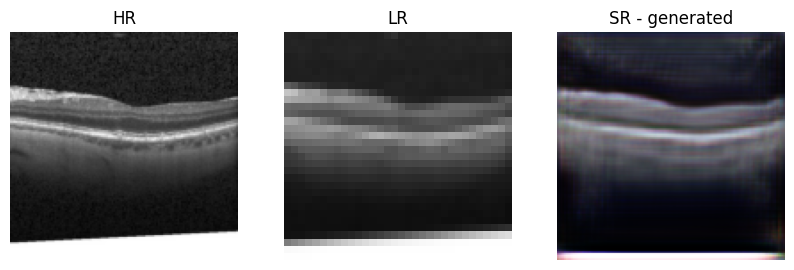

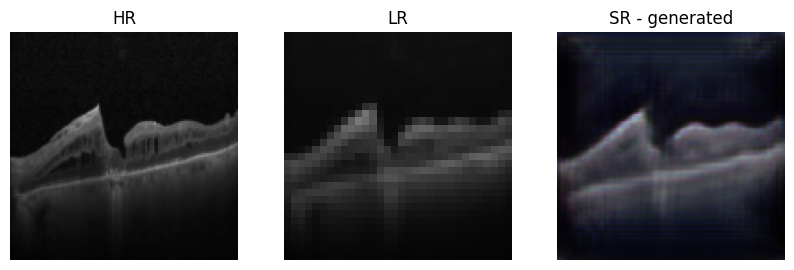

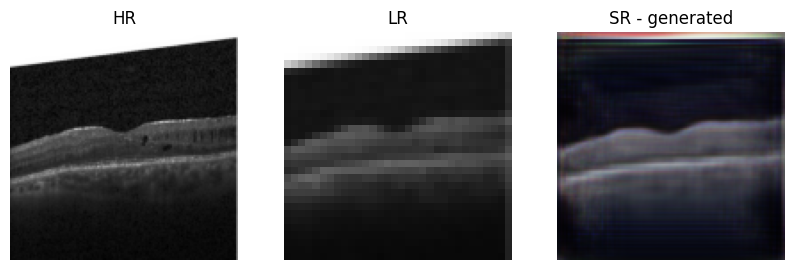

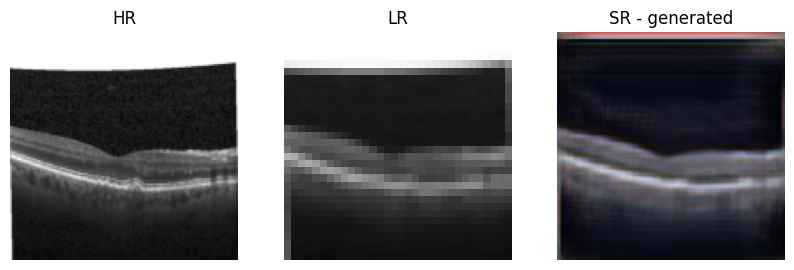

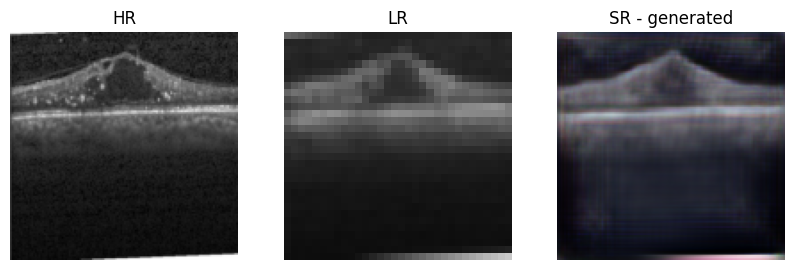

...

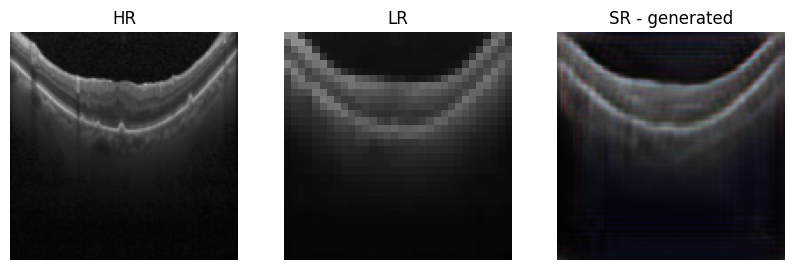

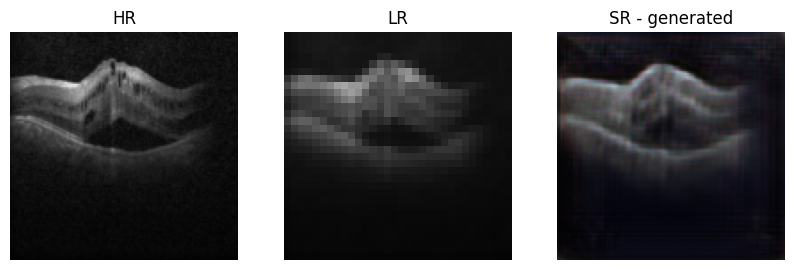

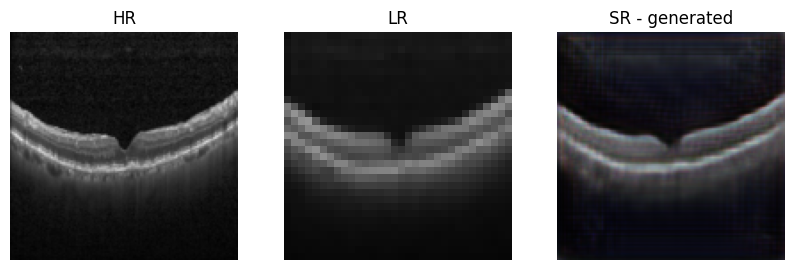

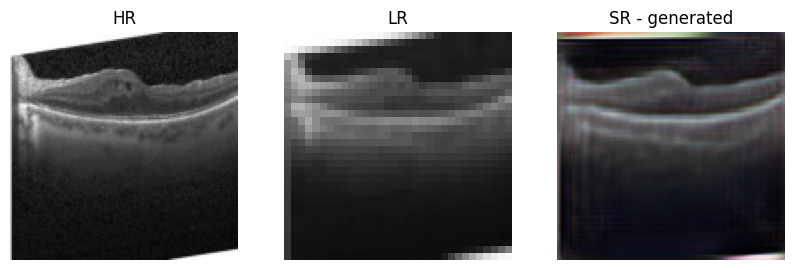

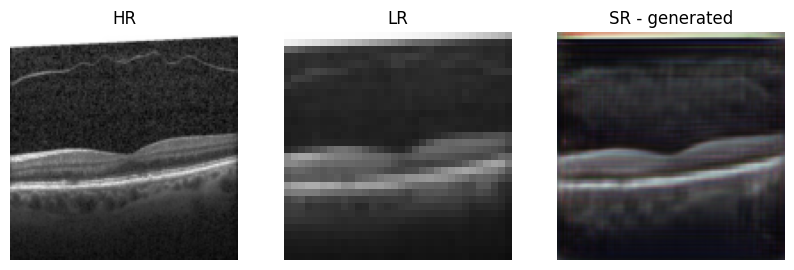

In [60]:
low_resolution_shape = (32, 32, 3)
high_resolution_shape = (128, 128, 3)
batch_size = 8
epochs = 150

d_history = []
g_history = []
psnr = {'psnr_quality': []}
ssim = {'ssim_quality': []}
losses = {'d_history': [], 'g_history': []}

for epoch in range(epochs):

    d_history = []
    g_history = []
    
    image_list = get_train_images(data_path)
    
    """
    Train the discriminator network
    """
    
    hr_images, lr_images = sample_images(image_list, 
                                         batch_size=batch_size,
                                         high_resolution_shape=(128, 128, 3),
                                         low_resolution_shape=(32, 32, 3))
                                         
    
    # generate high-resolution images from low-resolution images
    generated_high_resolution_images = generator.predict(lr_images)
    generated_high_resolution_images = upscale_images(generated_high_resolution_images, size=(128, 128))
    
    # normalize the images
    hr_images = hr_images / 127.5 - 1.
    generated_high_resolution_images = generated_high_resolution_images / 127.5 - 1.
    
    # generate a batch of true and fake labels 
    real_labels = np.ones((batch_size, 8, 8, 1))
    fake_labels = np.zeros((batch_size, 8, 8, 1))
    
    d_loss_real = discriminator.train_on_batch(hr_images, real_labels)
    d_loss_real =  np.mean(d_loss_real)
    d_loss_fake = discriminator.train_on_batch(generated_high_resolution_images, fake_labels)
    d_loss_fake =  np.mean(d_loss_fake)
    
    # calculate total loss of discriminator as average loss on true and fake labels
    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    losses['d_history'].append(d_loss)
   

    """
        Train the generator network
    """
      
    # sample a batch of images    
    hr_images, lr_images = sample_images(image_list, 
                                         batch_size=batch_size,
                                         low_resolution_shape=(32, 32, 3),
                                         high_resolution_shape=(128, 128, 3))
    
    # generate high-resolution images from low-resolution images
    generated_high_resolution_images = generator.predict(lr_images)
    generated_high_resolution_images = upscale_images(generated_high_resolution_images, size=(128, 128))
    
    # normalize the images
    hr_images = hr_images / 127.5 - 1.
    lr_images = lr_images / 127.5 - 1.
    generated_high_resolution_images = generated_high_resolution_images / 127.5 - 1.
    
    # extract feature maps for true high-resolution images
    image_features = fe_model.predict(hr_images)

    # train the generator
    g_loss = adversarial_model.train_on_batch([lr_images, hr_images],
                                               [real_labels, image_features])
    
    losses['g_history'].append(0.5 * (g_loss[1]))
    
    # calculate the psnr  
    ps = compute_psnr(hr_images, generated_high_resolution_images) 
    psnr['psnr_quality'].append(ps)
            
    # calculate the ssim 
    ss = compute_ssim(hr_images, generated_high_resolution_images)   
    ssim['ssim_quality'].append(ss)

    
    """
        save and print image samples
    """
    
    image_counter = 0

    # Save and print image samples
    if epoch % 10 == 0:
        image_batch_hr, image_batch_lr = sample_images(image_list, 16, high_resolution_shape, low_resolution_shape)

        # Normalize the images
        image_batch_hr = image_batch_hr / 127.5 - 1.
        image_batch_lr = image_batch_lr / 127.5 - 1.

        generated_images = generator.predict_on_batch(image_batch_lr)

        for index, img in enumerate(generated_images):
        # Increment the image counter
            image_counter += 1

            # Name the generated image using the epoch and index values
            image_name = "generated_image_e{}_{}.png".format(epoch, index)

            # Save the generated image in the "Generated Images" folder
            save_images(image_batch_hr[index], image_batch_lr[index], img, path="/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Generated Images/{}".format(image_name))
            
    """
        save the generator and discriminator .h5 files every 10 epoch
    """
    
    if epoch % 10 == 0:
        # Save the generator model as .h5 file
        generator.save('/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Generator_Epochs/generator_model_epoch_{}.h5'.format(epoch))

        # Save the discriminator model as .h5 file
        discriminator.save('/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Discriminator_Epochs/discriminator_model_epoch_{}.h5'.format(epoch))

In [ ]:
import os
import cv2
import numpy as np
from tensorflow.keras.models import load_model

# Load the generator model
generator_model = load_model('/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Generator_Epochs/generator_model_epoch_140.h5')

# Define the input and output shapes of the generator
input_shape = (32, 32, 3)
output_shape = (128, 128, 3)

# Define the path to the folder with the 32x32x3 images
data_path = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Downsized_32x32x3'

# Define the path to the folder to save the 128x128x3 images
output_path = '/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Upsized_128x128x3'

# Define a function to resize an image using the generator model
def resize_image(img):
    # Scale the pixel values to the range [-1, 1]
    img = img / 127.5 - 1.
    
    # Add a batch dimension to the image
    img = np.expand_dims(img, axis=0)
    
    # Generate the high-resolution image from the low-resolution image
    img_hr = generator_model.predict(img)[0]
    
    # Scale the pixel values back to the range [0, 255]
    img_hr = (img_hr + 1) * 127.5
    
    # Convert the pixel values to integers
    img_hr = img_hr.astype(np.uint8)
    
    return img_hr

# Loop over the subfolders in the data folder
for folder in os.listdir(data_path):
    folder_path = os.path.join(data_path, folder)
    
    # Create the output folder if it does not exist
    output_folder = os.path.join(output_path, folder)
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # Loop over the subfolders in the current folder
    for subfolder in os.listdir(folder_path):
        subfolder_path = os.path.join(folder_path, subfolder)
        
        # Create the output subfolder if it does not exist
        output_subfolder = os.path.join(output_folder, subfolder)
        if not os.path.exists(output_subfolder):
            os.makedirs(output_subfolder)
        
        # Loop over the images in the current subfolder
        for filename in os.listdir(subfolder_path):
            filepath = os.path.join(subfolder_path, filename)
            
            # Load the low-resolution image
            img_lr = cv2.imread(filepath)
            
            # Resize the image using the generator
            img_hr = resize_image(img_lr)
            
            # Save the high-resolution image in the output folder
            output_filename = os.path.join(output_subfolder, filename)
            cv2.imwrite(output_filename, img_hr)

In [1]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical

# Define the image size and the number of classes
img_size = 128
num_classes = 2

# Define the train and test directories
train_dir = r"/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Upsized_128x128x3/train"
test_dir = r"/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Upsized_128x128x3/test"

# Define the classes
classes = ['DME', 'DRUSEN']

# Create empty lists to store the data and labels
train_data = []
train_labels = []
test_data = []
test_labels = []

# Loop through the train directory to get the images and labels
for class_index, class_name in enumerate(classes):
    class_path = os.path.join(train_dir, class_name)
    for image_name in os.listdir(class_path):
        image_path = os.path.join(class_path, image_name)
        image = cv2.imread(image_path)
        image = cv2.resize(image, (img_size, img_size))
        train_data.append(image)
        train_labels.append(class_index)

# Loop through the test directory to get the images and labels
for class_index, class_name in enumerate(classes):
    class_path = os.path.join(test_dir, class_name)
    for image_name in os.listdir(class_path):
        image_path = os.path.join(class_path, image_name)
        image = cv2.imread(image_path)
        image = cv2.resize(image, (img_size, img_size))
        test_data.append(image)
        test_labels.append(class_index)

# Convert the data and labels to numpy arrays
train_data = np.array(train_data)
train_labels = np.array(train_labels)
test_data = np.array(test_data)
test_labels = np.array(test_labels)

# Split the data into training and validation sets
train_data, val_data, train_labels, val_labels = train_test_split(train_data, train_labels, test_size=0.2, random_state=42)

# Convert the labels to one-hot encoding
train_labels = to_categorical(train_labels, num_classes=num_classes)
val_labels = to_categorical(val_labels, num_classes=num_classes)
test_labels = to_categorical(test_labels, num_classes=num_classes)

2023-03-22 18:58:17.840387: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-22 18:58:17.915466: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-03-22 18:58:18.326775: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/jsmith/miniconda3/envs/tf/lib/python3.10/site-packages/cv2/../../lib64::/home/jsm

In [2]:
print(train_data[1].shape)

(128, 128, 3)


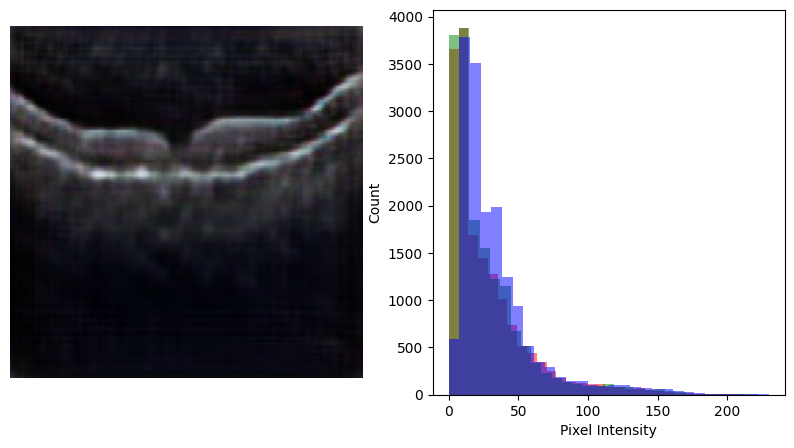

In [4]:
import matplotlib.pyplot as plt

def plotHistogram(a):
    """
    Plot histogram of RGB Pixel Intensities
    """
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(a)
    plt.axis('off')
    histo = plt.subplot(1,2,2)
    histo.set_ylabel('Count')
    histo.set_xlabel('Pixel Intensity')
    n_bins = 30
    plt.hist(a[:,:,0].flatten(), bins= n_bins, lw = 0, color='r', alpha=0.5);
    plt.hist(a[:,:,1].flatten(), bins= n_bins, lw = 0, color='g', alpha=0.5);
    plt.hist(a[:,:,2].flatten(), bins= n_bins, lw = 0, color='b', alpha=0.5);
    
plotHistogram(train_data[1])

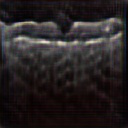

File: DME-3157783-53.jpeg Directory: train/DME Pixel size: (128, 128)


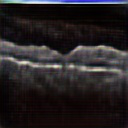

File: DME-4759696-5.jpeg Directory: train/DME Pixel size: (128, 128)


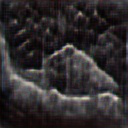

File: DME-6737988-57.jpeg Directory: train/DME Pixel size: (128, 128)


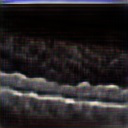

File: DME-3718895-42.jpeg Directory: train/DME Pixel size: (128, 128)


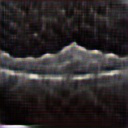

File: DME-8123126-4.jpeg Directory: train/DME Pixel size: (128, 128)


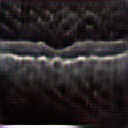

File: DRUSEN-5477211-4.jpeg Directory: train/DRUSEN Pixel size: (128, 128)


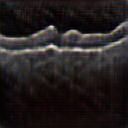

File: DRUSEN-732516-44.jpeg Directory: train/DRUSEN Pixel size: (128, 128)


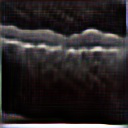

File: DRUSEN-8649762-14.jpeg Directory: train/DRUSEN Pixel size: (128, 128)


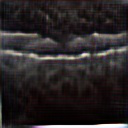

File: DRUSEN-2407494-15.jpeg Directory: train/DRUSEN Pixel size: (128, 128)


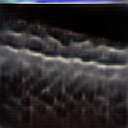

File: DRUSEN-3571629-5.jpeg Directory: train/DRUSEN Pixel size: (128, 128)


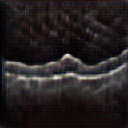

File: DME-30521-68.jpeg Directory: test/DME Pixel size: (128, 128)


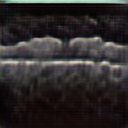

File: DME-258763-25.jpeg Directory: test/DME Pixel size: (128, 128)


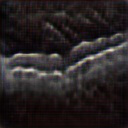

File: DME-30521-231.jpeg Directory: test/DME Pixel size: (128, 128)


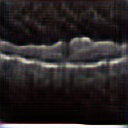

File: DME-119840-1.jpeg Directory: test/DME Pixel size: (128, 128)


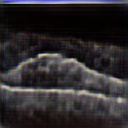

File: DME-258763-60.jpeg Directory: test/DME Pixel size: (128, 128)


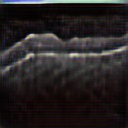

File: DRUSEN-142234-5.jpeg Directory: test/DRUSEN Pixel size: (128, 128)


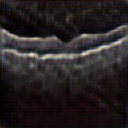

File: DRUSEN-364469-49.jpeg Directory: test/DRUSEN Pixel size: (128, 128)


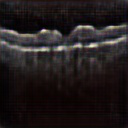

File: DRUSEN-228939-12.jpeg Directory: test/DRUSEN Pixel size: (128, 128)


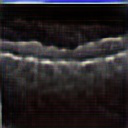

File: DRUSEN-224974-3.jpeg Directory: test/DRUSEN Pixel size: (128, 128)


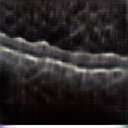

File: DRUSEN-95633-17.jpeg Directory: test/DRUSEN Pixel size: (128, 128)


In [1]:
import os
import random
from PIL import Image
from IPython.display import display

# Set the path to the directory
dir_path = "/home/jsmith/Desktop/JohnSmith_AssignmentMidtermProject/Data/Upsized_128x128x3/"

# Define the subdirectories
subdirs = ["train/DME", "train/DRUSEN", "test/DME", "test/DRUSEN"]

# Iterate over the subdirectories and select 10 random images
for subdir in subdirs:
    subdir_path = os.path.join(dir_path, subdir)
    files = os.listdir(subdir_path)
    sample_files = random.sample(files, 5)

    # Load and show the images
    for file in sample_files:
        file_path = os.path.join(subdir_path, file)
        image = Image.open(file_path)
        display(image)
        pixel_size = image.size
        print("File:", file, "Directory:", subdir, "Pixel size:", pixel_size)

In [8]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Sequential, model_from_json
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, Lambda, MaxPool2D, BatchNormalization
from tensorflow.keras import optimizers

# Load the VGG16 model without the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(img_size, img_size, 3))
optimizer  = optimizers.Adam(lr=0.00005)


# Freeze the base model layers
for layer in base_model.layers:
    layer.trainable = False

# Create the model and add the top layers
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))
predictions = Dense(num_classes, activation='softmax')
model.add(predictions) # Add predictions layer to the model


# Train top layer
for layer in base_model.layers:
    layer.trainable = False
    
# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
from tensorflow import keras
callbacks_list = [keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=3, verbose=1)]
    
# Print the model summary
model.summary()

# Train the model
history = model.fit(train_data, train_labels, batch_size=32, epochs=50, validation_data=(val_data, val_labels))

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(test_data, test_labels)
print('Test loss:', test_loss)
print('Test accuracy:', test_acc)

2023-03-22 19:00:18.007373: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 19:00:18.011644: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 19:00:18.011752: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-03-22 19:00:18.012356: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operati

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 128)               1048704   
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 2)                 258       
                                                                 
Total params: 15,763,650
Trainable params: 1,048,962
Non-trainable params: 14,714,688
_________________________________________________________________
Epoch 1/50


2023-03-22 19:00:20.040560: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8100
2023-03-22 19:00:21.209287: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1.14GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2023-03-22 19:00:21.209335: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1.14GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2023-03-22 19:00:21.209349: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 3.04GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if m

335/335 [==============================] - 31s 77ms/step - loss: 0.9613 - accuracy: 0.6583 - val_loss: 0.5262 - val_accuracy: 0.7328
Epoch 2/50
335/335 [==============================] - 22s 66ms/step - loss: 0.5408 - accuracy: 0.7203 - val_loss: 0.4899 - val_accuracy: 0.7706
Epoch 3/50
335/335 [==============================] - 22s 66ms/step - loss: 0.5006 - accuracy: 0.7494 - val_loss: 0.4664 - val_accuracy: 0.7709
Epoch 4/50
335/335 [==============================] - 22s 67ms/step - loss: 0.4738 - accuracy: 0.7618 - val_loss: 0.4598 - val_accuracy: 0.7754
Epoch 5/50
335/335 [==============================] - 22s 67ms/step - loss: 0.4530 - accuracy: 0.7718 - val_loss: 0.4638 - val_accuracy: 0.7649
Epoch 6/50
335/335 [==============================] - 22s 67ms/step - loss: 0.4343 - accuracy: 0.7860 - val_loss: 0.4352 - val_accuracy: 0.7922
Epoch 7/50
335/335 [==============================] - 22s 67ms/step - loss: 0.4184 - accuracy: 0.7916 - val_loss: 0.4279 - val_accuracy: 0.7922
Epo

In [9]:
from sklearn.metrics import confusion_matrix
import itertools

def plot_model_results(model, history, test_data, test_labels):
    # Plot accuracy and loss curves
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Val'], loc='upper left')

    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Val'], loc='upper left')

    plt.show()

    # Generate predictions for the test data
    y_pred = np.argmax(model.predict(test_data), axis=1)
    y_true = np.argmax(test_labels, axis=1)

    # Plot confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    classes = np.arange(len(np.unique(y_true)))
    fig, ax = plt.subplots(figsize=(6, 6))
    im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes, yticklabels=classes,
           title='Confusion Matrix',
           ylabel='True Label',
           xlabel='Predicted Label')
    plt.setp(ax.get_xticklabels(),
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        ax.text(j, i, format(cm[i, j], fmt),
                ha="center", va="center",
                color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()

    plt.show()

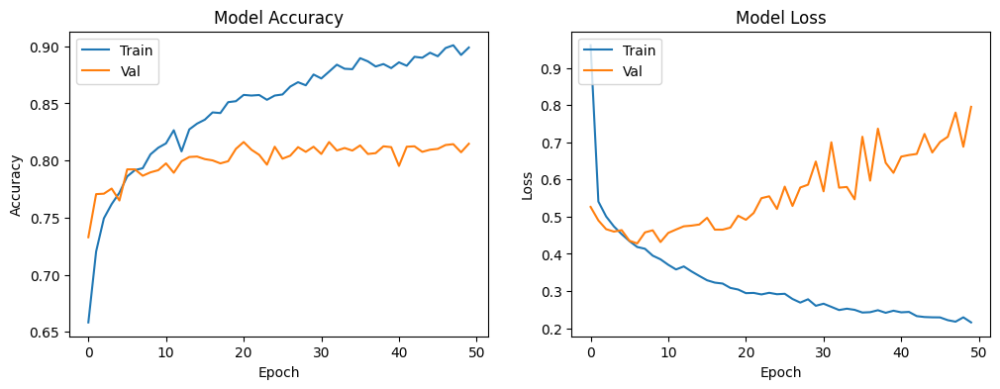

30/30 [==============================] - 2s 51ms/step


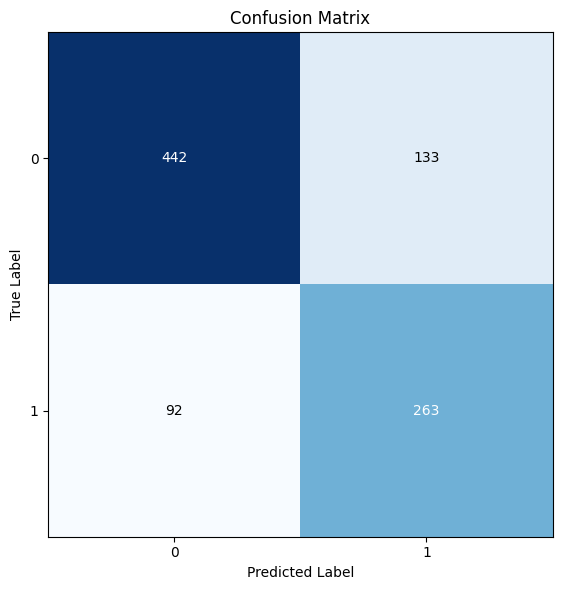

In [10]:
# Plot the model from HW1 with the original results
plot_model_results(model, history, test_data, test_labels)

The following charts are the output from Assignment2 which used the 128x128x3 original images for comparison. From the outputs of both assignments, we can see that, while decently close, the original images outperform the generated 128x128x3 images; specifically when it comes to validation loss. The generated images seem to be overfitting by a large marginto the point of increasing. This can be due to running 150 epochs vs the original 500 epochs which would have prodused a substantially better model. An additional note, I did not rename the model when copying the below model so, if the notebook is re-ran in its entirety, the Assignment2 model below will be overridden with the original model. But, will still be available above in the first few cells. 

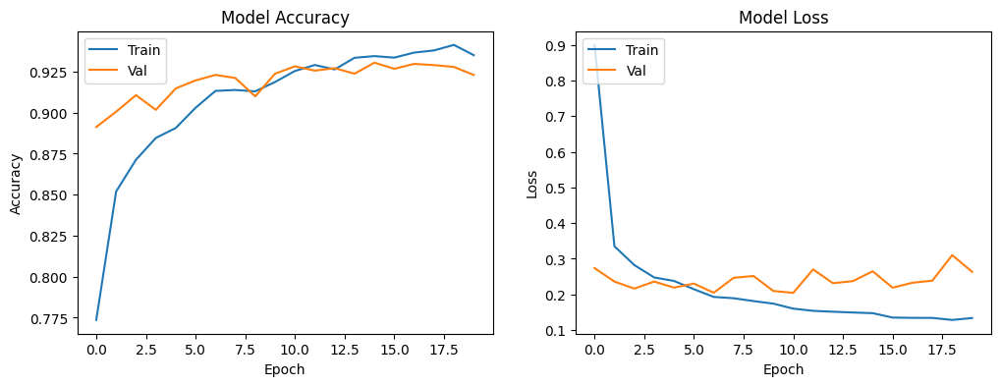

30/30 [==============================] - 1s 51ms/step


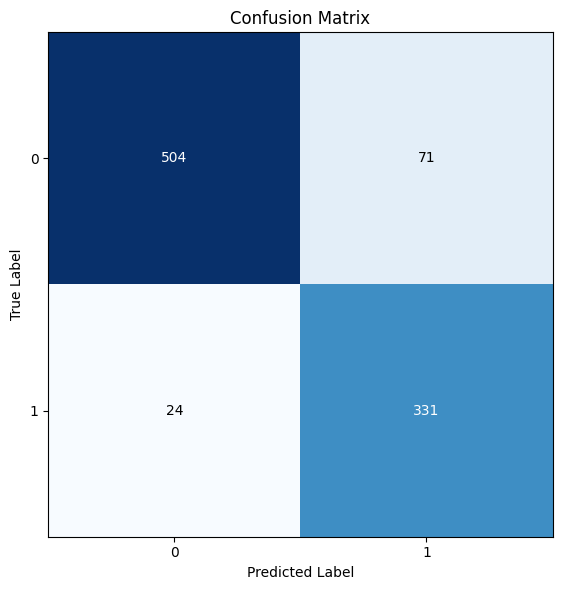

In [18]:
# Plot the model from HW1 with the original results
plot_model_results(model, history, test_data, test_labels)